## Starter Problems

#### Strang Matrix Problem

Use Julia's array and control flow syntax in order to define the NxN Strang matrix:

$$ \left[\begin{array}{ccccc}
-2 & 1\\
1 & -2 & 1\\
 & \ddots & \ddots & \ddots\\
 &  & \ddots & \ddots & 1\\
 &  &  & 1 & -2
\end{array}\right] $$

i.e. a matrix with `-2` on the diagonal, 1 on the off-diagonals, and 0 elsewere.

In [31]:
function StrangMatrix(N)
    matrix = zeros(N,N)
    
    for i = 1:N
        for j = 1:N
            if i == j
                matrix[i,j] = -2            
            elseif j == i+1
                matrix[i,j] = 1
            elseif j == i-1
                matrix[i,j] = 1
            end
        end
    end
    return matrix
end

StrangMatrix (generic function with 1 method)

In [32]:
M = StrangMatrix(5)

5×5 Array{Float64,2}:
 -2.0   1.0   0.0   0.0   0.0
  1.0  -2.0   1.0   0.0   0.0
  0.0   1.0  -2.0   1.0   0.0
  0.0   0.0   1.0  -2.0   1.0
  0.0   0.0   0.0   1.0  -2.0

#### Factorial Problem*

Using a `for` loop, write a function `my_factorial(n)` that computes the `n`th factorial. Try your function on integers like `15`

Bonus: Use `BigInt` inputs like `big(100)`. Make your function's output type match the input type for `n`. You'll know that you'll successfully matched the input type if your output does not "overflow" to negative, and you can check `typeof(x)`. Hint, you may want to initialize a value using `one(x)`, which is the value `1` in the type that matches `x`.

In [111]:
function my_factorial(n) 
    if n == 0
        return 1
    end
    
    factorial = big"1"
    
    for i in 1:n
        factorial *= i
    end
    
    return factorial
end

my_factorial (generic function with 1 method)

In [112]:
my_factorial(100)

93326215443944152681699238856266700490715968264381621468592963895217599993229915608941463976156518286253697920827223758251185210916864000000000000000000000000

#### Binomial Problem*

A random variable `X~Bin(n,p)` is defined the number of successes in `n` trials where each trial has a success probability `p`. For example, if `Bin(10,0.5)`, then `X` is the number of coin flips that turn up heads in `10` flips. 

Using only `rand()` (uniform random numbers), write a function `binomial_rv(n,p)` that produces one draw of `Bin(n,p)`.

In [115]:
function binomial_rv(n, p)
    x = rand(0:n)
    nCr = my_factorial(n)/( my_factorial(x) * my_factorial(n-x) )
    p = nCr * (p^x) * ((1-p)^(n-x))
    return p
end

binomial_rv (generic function with 1 method)

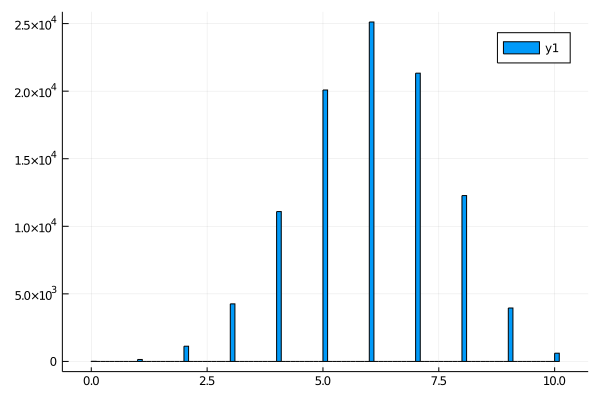

In [124]:
using Plots
using Distributions
p = [binomial_rv(10,0.6) for i in 1:100000]
histogram(p)

#### Monte Carlo $\pi$ Problem*
Use random number generation to estimate $\pi$. To do so, mentally draw the unit circle. It is encompassed in the square $[-1,1]\times[-1,1]$. The area of the circle is $\pi r^2 = \pi$. The area of the square is $4$. Thus if points are randomly taken evenly from $[-1,1]\times[-1,1]$, then the probability they land in the circle ($x^2 + y^2\leq 1$) is $\frac{\pi}{4}$. Use this to estimate $\pi$.

In [140]:
count  = 0
iter = 10000000
for i in 1:iter
    x, y = 2rand(2) .- 1
    if ((x^2) + (y^2) - 1) < 0
        count += 1
    end
end

pi = count / iter
pi *= 4
print(pi)


3.1420612

## Integration Problems
These problems integrate basic workflow tools to solve some standard data science and scientific computing problems.

#### Timeseries Generation Problem*

An AR1 timeseries is defined by

$$ x_{t+1} = \alpha x_i + \epsilon_{t+1} $$

where $x_0 = 0$ and $t=0,\ldots,T$. The shocks ${\epsilon_t}$ are i.i.d. standard normal (`N(0,1)`, given by `randn()`). Using $T=200$ 

1. $\alpha = 0$
2. $\alpha = 0.5$
3. $\alpha = 0.9$

use Plots.jl to plot a timecourse for each of the parameters. Label the lines for the values of $\alpha$ that generate them using the `label` argument in `plot`.

In [143]:
function AR_timeseries(α, T=200)
    ts = zeros(T,1)
    ts[1] = 0
    for i in 2:T
        ts[i] = α*ts[i-1] + randn()
    end
    return ts
end

AR_timeseries (generic function with 3 methods)

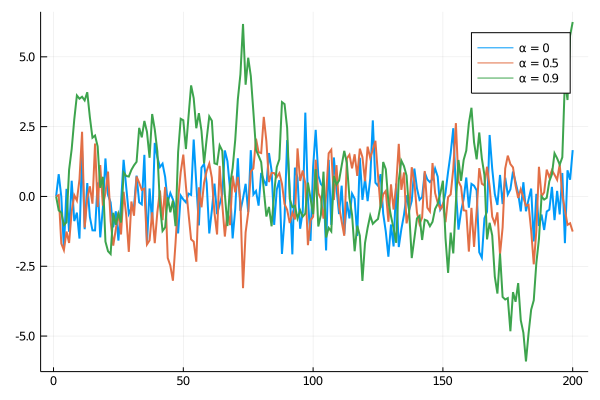

In [152]:
ts_0 = AR_timeseries(0)
ts_05 = AR_timeseries(0.5)
ts_09 = AR_timeseries(0.9)

plot(ts_0, label="α = 0", lw=2)
plot!(ts_05, label="α = 0.5", lw=2)
plot!(ts_09, label="α = 0.9", lw=2)

#### Logistic Map Problem

The logistic difference equation is defined by the recursion

$$ b_{n+1}=r*b_{n}(1-b_{n}) $$

where $b_{n}$ is the number of bunnies at time $n$. Starting with $b_{0}=.25$, by around $400$ iterations this will reach a steady state. This steady state (or steady periodic state) is dependent on $r$. Write a function which plots the steady state attractor. This is done as follows:

1) Solve for the steady state(s) for each given $r$ (i.e. iterate the relation 400 times).

2) Calculate "every state" in the steady state attractor. This means, at steady state (after the first 400 iterations), save the next 150 values. Call this set of values $y_s(r)$.

3) Do steps (1) and (2) with $r\in\left(2.9,4\right)$, `dr=.001`. Plot $r$ x-axis vs $y_s(r)$=value seen in the attractor) using Plots.jl. Your result should be the [Logistic equation bifurcation diagram](https://upload.wikimedia.org/wikipedia/commons/7/7d/LogisticMap_BifurcationDiagram.png).

In [159]:
function SolveLogisticEquation(r, ϵ = 1e-8)
    
    b_prev = 0.25
    ys = zeros(150,1)
    for i = 1:550
        b = r * b_prev * (1 - b_prev)
        b_prev = b
        if i > 400
           ys[i-400] = b
        end
    end
    return ys
end

SolveLogisticEquation (generic function with 2 methods)

In [160]:
x = Float64[]
b = Float64[]
for r in 2.9:0.001:4
    ys = SolveLogisticEquation(r)
    for y in ys
        push!(x,r)
        push!(b,y)
    end
end

plot(x,b,seriestype=:scatter,markersize=.002,legend=false,color=:black)